# GPU programming using PyOpenCL, part 1: Map

This is a set of exercises on the usage of PyOpenCL. There are 6 main classes of parallel algorithms:
1. Map or Element-wise kernels: 1 thread calculates 1 result from 1 input
2. Gather: 1 thread calculates 1 result from several input data, one typical example is the convolution
3. Scatter: 1 thread uses 1 input element and scatters it on one or several output pixels, this requires the usage of atomic operarions
4. Reduction: Apply the same associative operation on all element of an ensemble, for example the sum of all elements in a list.
5. Scan: also called prefix sum, this algorithm applies the same associative operation to all *previous* elements of a list, for example a cummulative sum (cumsum)
6. Sort: using sorting network like the bitonic sort.

This first tutorial focuses on the Map operation applied to (visible light) image treatement. 
It consists of two part: an example of usage, followed by the direct application in an exercise to be done.

First we load some python modules to be able to read and display images. Then we initialize OpenCL, a context, a command queue, ...

In [1]:
%matplotlib widget
from math import ceil
import numpy as np
from PIL import Image
from matplotlib.pyplot import subplots

In [ ]:
import pyopencl as cl
from pyopencl import array as cla

ctx = cl.create_some_context(interactive=False)
queue = cl.CommandQueue(ctx, properties=cl.command_queue_properties.PROFILING_ENABLE)

print(ctx.devices[0])

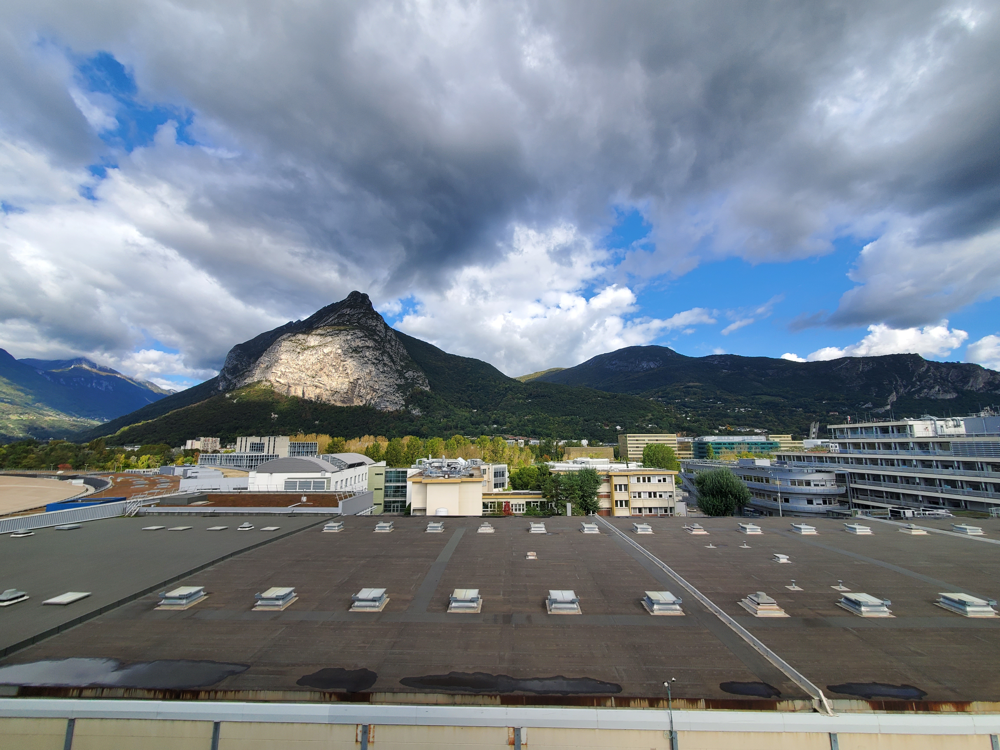

In [42]:
filename = "14h33m35-SM-N970U1.jpg"
Image.open(filename)

In [43]:
img = np.array(Image.open(filename))
img_d = cla.to_device(queue, img)

In [38]:
img.shape, img.dtype;

## Demonstration 1: Convert an image in Black & White:

For this, we use this formula:

$$ Y = 0.299 R + 0.587 G + 0.114 B $$

Or the Numpy implementation: 

In [45]:
R, G, B = img.reshape((-1,3)).T
Y = 0.299*R + 0.587*G + 0.114*B
%timeit Y = 0.299*R+0.587*G+0.114*B
Y.shape = img.shape[:2]
Y.shape, Y.dtype

97.9 ms ± 2.53 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


((3456, 4608), dtype('float64'))

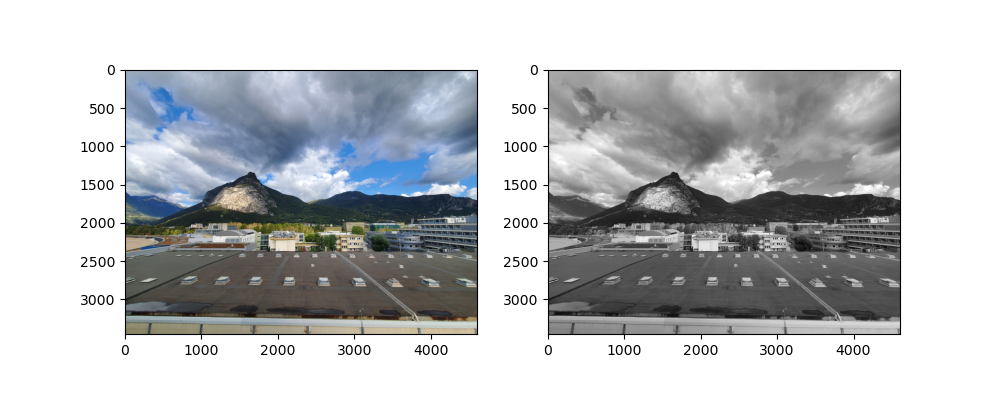

In [7]:
fig, ax = subplots(1, 2, figsize=(10,4))
ax[0].imshow(img)
ax[1].imshow(Y, cmap="gray")

### Using an explicit kernel implementation in PyOpenCl:


In [8]:
Y_d = cla.empty(queue, img.shape[:2], "float32")
wg = None #(32, 32)
shape = img.shape[:2] if wg is None else tuple(int(ceil(i/w)*w) for i,w in zip(img.shape, wg))
shape, wg

((3456, 4608), None)

In [9]:
%load_ext pyopencl.ipython_ext

In [46]:
%%cl_kernel

kernel void luma(global uchar *rgb, 
                 global float *L, 
                 int height, 
                 int width)
{
    int x, y;
    y = get_global_id(0);
    x = get_global_id(1);
    if ((x<width) && (y<height))
    {
        int i;
        i = x + width*y;
        L[i] = 0.299f * rgb[3*i]
             + 0.587f * rgb[3*i+1]
             + 0.114f * rgb[3*i+2];
    }
}

In [47]:
# %%timeit 
evt = luma(queue, shape, wg,
           img_d.data, Y_d.data, 
           np.int32(img.shape[0]), np.int32(img.shape[1]))

LogicError: clSetKernelArg failed: INVALID_MEM_OBJECT - when processing arg#2 (1-based): 

In [12]:
evt.wait()

In [13]:
print(f"Profile time: {(evt.profile.end-evt.profile.start)*1e-6:.3f}ms")

Profile time: 5.845ms


In [14]:
# %%timeit 
# evt = luma(queue, shape, wg,
#            img_d.data, Y_d.data, 
#            np.int32(img.shape[0]), np.int32(img.shape[1]))

In [15]:
%%timeit 
luma(queue, shape, wg,
     img_d.data, Y_d.data, 
     np.int32(img.shape[0]), np.int32(img.shape[1])).wait()

5.9 ms ± 13.5 μs per loop (mean ± std. dev. of 7 runs, 100 loops each)


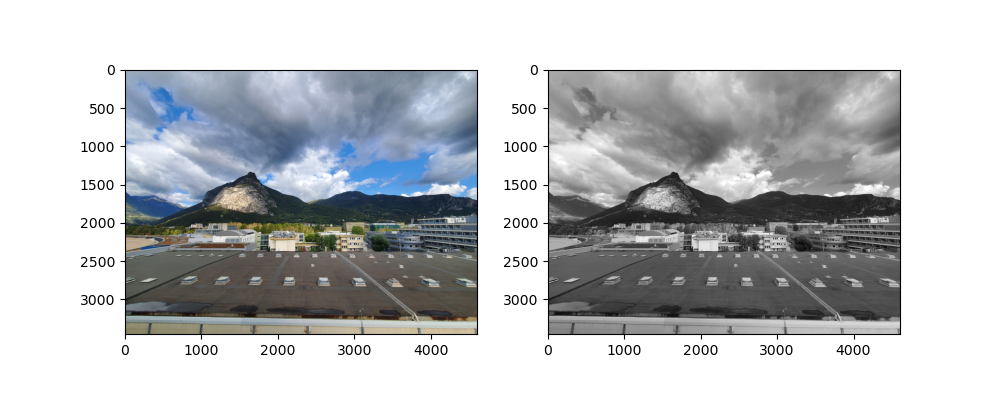

In [16]:
fig, ax = subplots(1, 2, figsize=(10,4))
ax[0].imshow(img)
ax[1].imshow(Y_d.get(), cmap="gray")

In [17]:
np.allclose(Y, Y_d.get())

True

### Using the PyOpenCL algorithm: ElementWise

In [18]:
from pyopencl.elementwise import ElementwiseKernel

In [19]:
# Note one needs to use the output array as first argument so that 
luma_ew = ElementwiseKernel(ctx, 
                            arguments="float *L, uchar *rgb", 
                            operation="L[i] = 0.299 * rgb[3*i] + 0.587 * rgb[3*i+1] + 0.114 * rgb[3*i+2]")

In [20]:
evt = luma_ew(Y_d, img_d)

In [21]:
evt.wait()

In [22]:
np.allclose(Y, Y_d.get())

True

In [23]:
print(f"Profile time: {(evt.profile.end-evt.profile.start)*1e-6:.3f}ms")

Profile time: 3.647ms


In [24]:
%timeit luma_ew(Y_d, img_d).wait()

3.67 ms ± 26.2 μs per loop (mean ± std. dev. of 7 runs, 100 loops each)


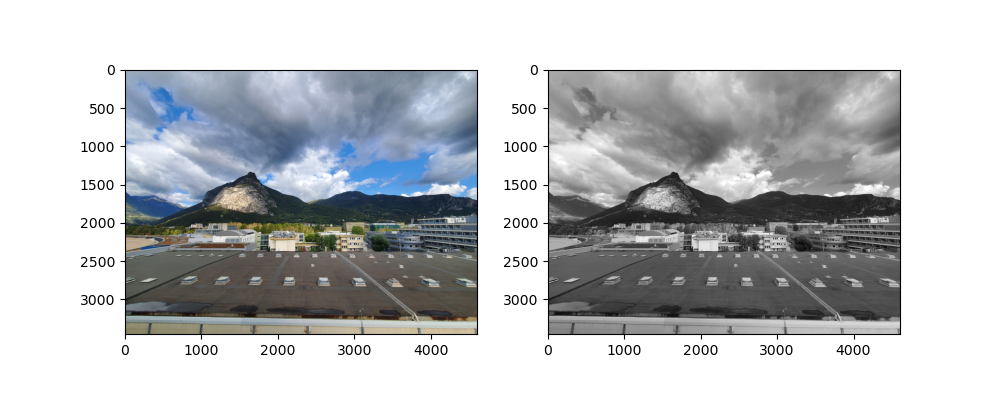

In [25]:
fig, ax = subplots(1, 2, figsize=(10,4))
ax[0].imshow(img)
ax[1].imshow(Y_d.get(), cmap="gray")

## Variation: Same with desaturation
i.e. max(R,G,B)

In [39]:
R, G, B = img.reshape((-1,3)).T
D = np.maximum(R,np.maximum(G,B))
%timeit np.maximum(R,np.maximum(G,B))
D.shape = img.shape[:2]

42 ms ± 15 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


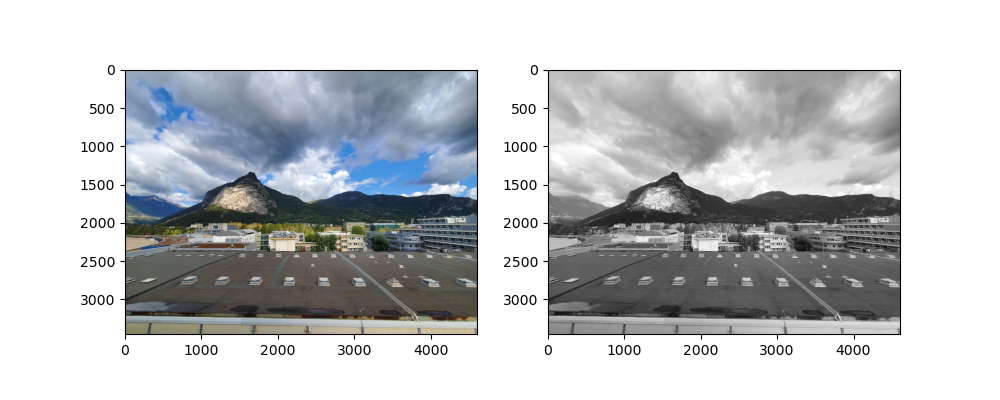

In [40]:
fig, ax = subplots(1, 2, figsize=(10,4))
ax[0].imshow(img)
ax[1].imshow(D, cmap="gray")

In [41]:
from pyopencl import cufft

ImportError: cannot import name 'cufft' from 'pyopencl' (/home/kieffer/miniforge3/lib/python3.12/site-packages/pyopencl/__init__.py)